In [1]:
import pandas as pd
pd.set_option('display.max_columns', None) # Show all columns
pd.set_option('display.max_rows', None)      # Limit number of rows shown
pd.set_option('display.width', 1000)       # Width of the display in characters

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
import scipy.stats as stats
import seaborn as sns
from sklearn import linear_model
import statsmodels.api as sm 
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import cross_val_score

In [3]:
price = pd.read_csv('Ames_HousePrice.csv')
price.drop(columns=['Unnamed: 0'], inplace=True)
price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,909176150,856,126000,30,RL,NaN,7890,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,CBlock,TA,TA,No,Rec,238.0,Unf,0.0,618.0,856.0,GasA,TA,Y,SBrkr,856,0,0,1.0,0.0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2.0,399.0,TA,TA,Y,0,0,0,0,166,0,NaN,NaN,NaN,0,3,2010,WD,Normal
1,905476230,1049,139500,120,RL,42.0,4235,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149.0,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552.0,ALQ,393.0,104.0,1049.0,GasA,TA,Y,SBrkr,1049,0,0,1.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1984.0,Fin,1.0,266.0,TA,TA,Y,0,105,0,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal
2,911128020,1001,124900,30,C (all),60.0,6060,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,TA,BrkTil,TA,TA,No,ALQ,737.0,Unf,0.0,100.0,837.0,GasA,Ex,Y,SBrkr,1001,0,0,0.0,0.0,1,0,2,1,Gd,5,Typ,0,NaN,Detchd,1930.0,Unf,1.0,216.0,TA,Po,N,154,0,42,86,0,0,NaN,NaN,NaN,0,11,2007,WD,Normal
3,535377150,1039,114000,70,RL,80.0,8146,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0.0,Unf,0.0,405.0,405.0,GasA,Gd,Y,SBrkr,717,322,0,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1940.0,Unf,1.0,281.0,TA,TA,N,0,0,168,0,111,0,NaN,NaN,NaN,0,5,2009,WD,Normal
4,534177230,1665,227000,60,RL,70.0,8400,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,643.0,Unf,0.0,167.0,810.0,GasA,Ex,Y,SBrkr,810,855,0,1.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,2001.0,Fin,2.0,528.0,TA,TA,Y,0,45,0,0,0,0,NaN,NaN,NaN,0,11,2009,WD,Normal
5,908128060,1922,198500,85,RL,64.0,7301,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500.0,Gd,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,495,1427,0,0.0,0.0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2.0,672.0,TA,TA,Y,0,0,177,0,0,0,NaN,NaN,NaN,0,7,2009,ConLD,Normal
6,902135020,936,93000,20,RM,60.0,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Fa,TA,CBlock,Fa,TA,No,Unf,0.0,Unf,0.0,936.0,936.0,GasA,TA,N,SBrkr,936,0,0,0.0,0.0,1,0,2,1,TA,4,Min2,0,NaN,Detchd,1974.0,Unf,2.0,576.0,TA,TA,Y,0,32,112,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal
7,528228540,1246,187687,20,RL,53.0,3710,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20.0,Gd,TA,PConc,Gd,TA,Gd,Unf,0.0,Unf,0.0,1146.0,1146.0,GasA,Ex,Y,SBrkr,1246,0,0,0.0,0.0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2.0,428.0,TA,TA,Y,100,24,0,0,0,0,NaN,NaN,NaN,0,3,2008,New,Partial
8,923426010,889,137500,20,RL,74.0,12395,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,6,1984,1984,Gable,CompShg,HdBoard,Plywood,NaN,0.0,TA,TA,CBlock,TA,TA,No,ALQ,647.0,Unf,0.0,217.0,864.0,GasA,TA,Y,SBrkr,889,0,0,0.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1984.0,Unf,2.0,484.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Normal
9,9081860

In [4]:
columns_to_sum = [
    'PoolArea', 'EnclosedPorch', 'ScreenPorch', 'OpenPorchSF', 'WoodDeckSF',
    '3SsnPorch', 'GarageArea', 'GrLivArea', 'TotalBsmtSF', 'MasVnrArea'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalArea'] = price[columns_to_sum].fillna(0).sum(axis=1)

price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea
0,909176150,856,126000,30,RL,NaN,7890,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,CBlock,TA,TA,No,Rec,238.0,Unf,0.0,618.0,856.0,GasA,TA,Y,SBrkr,856,0,0,1.0,0.0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2.0,399.0,TA,TA,Y,0,0,0,0,166,0,NaN,NaN,NaN,0,3,2010,WD,Normal,2277.0
1,905476230,1049,139500,120,RL,42.0,4235,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149.0,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552.0,ALQ,393.0,104.0,1049.0,GasA,TA,Y,SBrkr,1049,0,0,1.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1984.0,Fin,1.0,266.0,TA,TA,Y,0,105,0,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal,2618.0
2,911128020,1001,124900,30,C (all),60.0,6060,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,TA,BrkTil,TA,TA,No,ALQ,737.0,Unf,0.0,100.0,837.0,GasA,Ex,Y,SBrkr,1001,0,0,0.0,0.0,1,0,2,1,Gd,5,Typ,0,NaN,Detchd,1930.0,Unf,1.0,216.0,TA,Po,N,154,0,42,86,0,0,NaN,NaN,NaN,0,11,2007,WD,Normal,2336.0
3,535377150,1039,114000,70,RL,80.0,8146,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0.0,Unf,0.0,405.0,405.0,GasA,Gd,Y,SBrkr,717,322,0,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1940.0,Unf,1.0,281.0,TA,TA,N,0,0,168,0,111,0,NaN,NaN,NaN,0,5,2009,WD,Normal,2004.0
4,534177230,1665,227000,60,RL,70.0,8400,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,643.0,Unf,0.0,167.0,810.0,GasA,Ex,Y,SBrkr,810,855,0,1.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,2001.0,Fin,2.0,528.0,TA,TA,Y,0,45,0,0,0,0,NaN,NaN,NaN,0,11,2009,WD,Normal,3048.0
5,908128060,1922,198500,85,RL,64.0,7301,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500.0,Gd,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,495,1427,0,0.0,0.0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2.0,672.0,TA,TA,Y,0,0,177,0,0,0,NaN,NaN,NaN,0,7,2009,ConLD,Normal,3271.0
6,902135020,936,93000,20,RM,60.0,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Fa,TA,CBlock,Fa,TA,No,Unf,0.0,Unf,0.0,936.0,936.0,GasA,TA,N,SBrkr,936,0,0,0.0,0.0,1,0,2,1,TA,4,Min2,0,NaN,Detchd,1974.0,Unf,2.0,576.0,TA,TA,Y,0,32,112,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal,2592.0
7,528228540,1246,187687,20,RL,53.0,3710,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20.0,Gd,TA,PConc,Gd,TA,Gd,Unf,0.0,Unf,0.0,1146.0,1146.0,GasA,Ex,Y,SBrkr,1246,0,0,0.0,0.0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2.0,428.0,TA,TA,Y,100,24,0,0,0,0,NaN,NaN,NaN,0,3,2008,New,Partial,2964.0
8,923426010,889,137500,20,RL,74.0,12395,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,6,1984,1984,Gable,CompShg,HdBoard,Plywood,NaN,0.0,TA,TA,CBlock,TA,TA,No,ALQ,647.0,Unf,0.0,217.0,864.0,GasA,TA,Y,SBrkr,889,0,0,0.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1984.0,Unf,2.0,

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.731
Model:                            OLS   Adj. R-squared:                  0.731
Method:                 Least Squares   F-statistic:                     7009.
Date:                Tue, 17 Jun 2025   Prob (F-statistic):               0.00
Time:                        13:59:31   Log-Likelihood:                -30928.
No. Observations:                2580   AIC:                         6.186e+04
Df Residuals:                    2578   BIC:                         6.187e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -1.959e+04   2482.118     -7.892      0.0

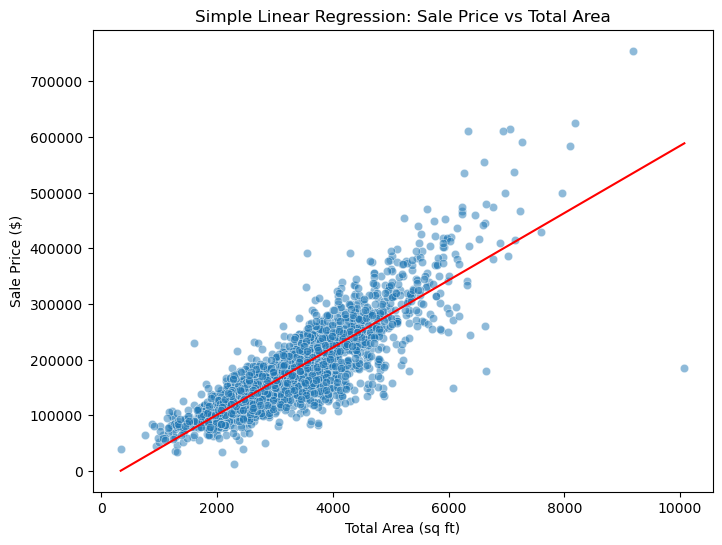

In [5]:
# 1. Create the feature (X) and target (y)
X = price['TotalArea']
y = price['SalePrice']

# 2. Add a constant to X (for the intercept term)
X = sm.add_constant(X)

# 3. Fit the OLS (Ordinary Least Squares) regression
model = sm.OLS(y, X).fit()

# 4. Print the regression summary
print(model.summary())

# 5. Plot the regression line
plt.figure(figsize=(8, 6))
sns.scatterplot(x=price['TotalArea'], y=price['SalePrice'], alpha=0.5)
sns.lineplot(x=price['TotalArea'], y=model.predict(X), color='red')  # predicted line
plt.title('Simple Linear Regression: Sale Price vs Total Area')
plt.xlabel('Total Area (sq ft)')
plt.ylabel('Sale Price ($)')
plt.show()

Intercept: -19589.46
Slope: 60.38
RSS: 3,904,383,450,781.33
R²: 0.7311


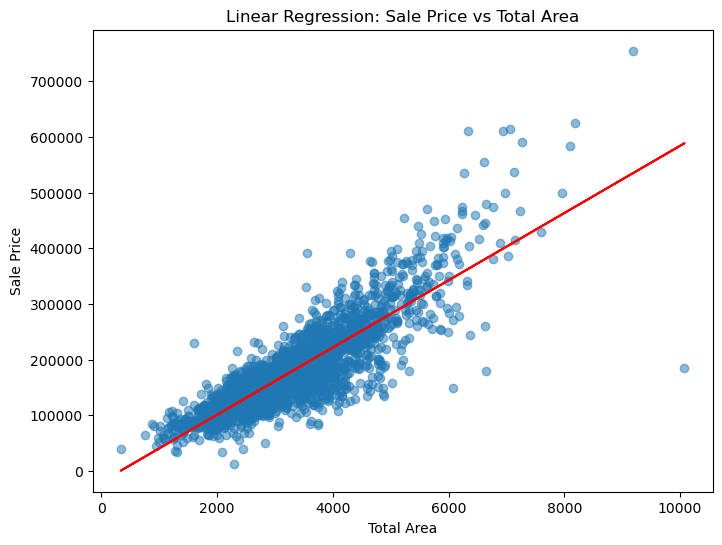

In [6]:
# 1. Create feature (X) and target (y)
X = price[['TotalArea']]  # double brackets to make it a 2D array
y = price['SalePrice']

# 2. Create the model
ols = linear_model.LinearRegression()

# 3. Fit the model
ols.fit(X, y)

# 4. Predict
y_pred = ols.predict(X)

# 5. Calculate residuals
residuals = y - y_pred

# 6. Calculate RSS
RSS = np.sum(residuals ** 2)

# 7. Calculate TSS
TSS = np.sum((y - np.mean(y)) ** 2)

# 8. Calculate R² manually
R_squared = 1 - (RSS / TSS)

# 9. Print results
print(f"Intercept: {ols.intercept_:.2f}")
print(f"Slope: {ols.coef_[0]:.2f}")
print(f"RSS: {RSS:,.2f}")
print(f"R²: {R_squared:.4f}")

# 10. Scatter plot + line
plt.figure(figsize=(8,6))
plt.scatter(X, y, alpha=0.5)
plt.plot(X, y_pred, color='red')
plt.title('Linear Regression: Sale Price vs Total Area')
plt.xlabel('Total Area')
plt.ylabel('Sale Price')
plt.show()

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.075
Model:                            OLS   Adj. R-squared:                  0.075
Method:                 Least Squares   F-statistic:                     210.0
Date:                Tue, 17 Jun 2025   Prob (F-statistic):           8.30e-46
Time:                        13:59:33   Log-Likelihood:                -32522.
No. Observations:                2580   AIC:                         6.505e+04
Df Residuals:                    2578   BIC:                         6.506e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.524e+05   2269.291     67.165      0.0

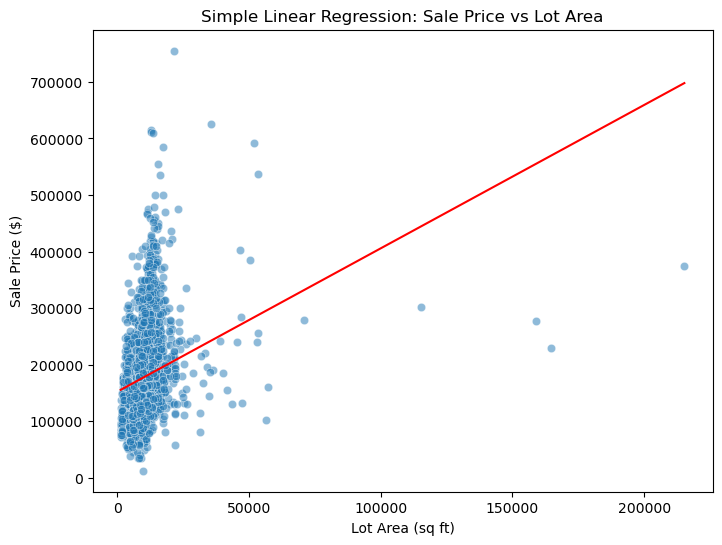

In [7]:
# 1. Create the feature (X) and target (y)
X = price['LotArea']
y = price['SalePrice']

# 2. Add a constant to X (for the intercept term)
X = sm.add_constant(X)

# 3. Fit the OLS (Ordinary Least Squares) regression
model = sm.OLS(y, X).fit()

# 4. Print the regression summary
print(model.summary())

# 5. Plot the regression line
plt.figure(figsize=(8, 6))
sns.scatterplot(x=price['LotArea'], y=price['SalePrice'], alpha=0.5)
sns.lineplot(x=price['LotArea'], y=model.predict(X), color='red')  # predicted line
plt.title('Simple Linear Regression: Sale Price vs Lot Area')
plt.xlabel('Lot Area (sq ft)')
plt.ylabel('Sale Price ($)')
plt.show()

Intercept: 152417.48
Slope: 2.53
RSS: 13,425,351,987,660.84
R²: 0.0753


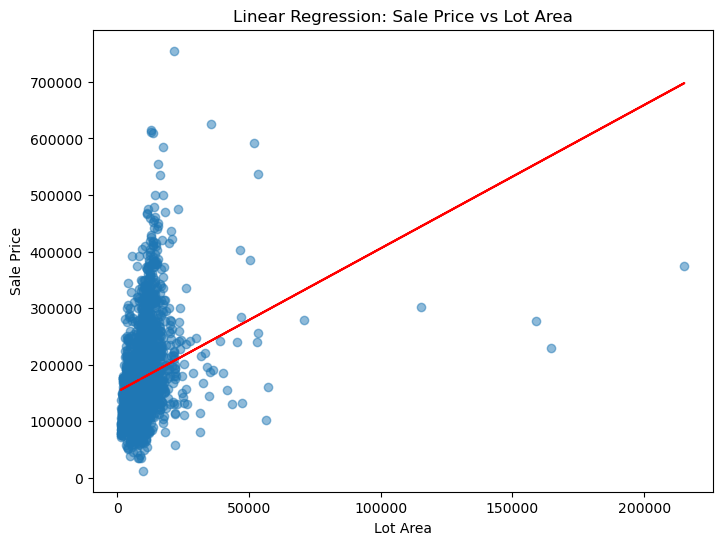

In [8]:
# 1. Create feature (X) and target (y)
X1 = price[['LotArea']]  # double brackets to make it a 2D array
y1 = price['SalePrice']


# 3. Fit the model
ols.fit(X1, y1)

# 4. Predict
y_pred1 = ols.predict(X1)

# 5. Calculate residuals
residuals1 = y1 - y_pred1

# 6. Calculate RSS
RSS1 = np.sum(residuals1 ** 2)

# 7. Calculate TSS
TSS1 = np.sum((y1 - np.mean(y1)) ** 2)

# 8. Calculate R² manually
R_squared1 = 1 - (RSS1 / TSS1)

# 9. Print results
print(f"Intercept: {ols.intercept_:.2f}")
print(f"Slope: {ols.coef_[0]:.2f}")
print(f"RSS: {RSS1:,.2f}")
print(f"R²: {R_squared1:.4f}")

# 10. Scatter plot + line
plt.figure(figsize=(8,6))
plt.scatter(X1, y1, alpha=0.5)
plt.plot(X1, y_pred1, color='red')
plt.title('Linear Regression: Sale Price vs Lot Area')
plt.xlabel('Lot Area')
plt.ylabel('Sale Price')
plt.show()

In [9]:
price['Alley'] = price['Alley'].fillna('No Alley Access')
price['MasVnrType'] = price['MasVnrType'].fillna('None')
price['BsmtQual'] = price['BsmtQual'].fillna('No Basement')
price['BsmtCond'] = price['BsmtCond'].fillna('No Basement')
price['BsmtExposure'] = price['BsmtExposure'].fillna('No Basement')
price['BsmtFinType1'] = price['BsmtFinType1'].fillna('No Basement')
price['BsmtFinType2'] = price['BsmtFinType2'].fillna('No Basement')
price['FireplaceQu'] = price['FireplaceQu'].fillna('No Fireplace')
price['GarageType'] = price['GarageType'].fillna('No Garage')
price['GarageYrBlt'] = price['GarageYrBlt'].fillna('No Garage')
price['GarageFinish'] = price['GarageFinish'].fillna('No Garage')
price['GarageQual'] = price['GarageQual'].fillna('No Garage')
price['GarageCond'] = price['GarageCond'].fillna('No Garage')
price['PoolQC'] = price['PoolQC'].fillna('No Pool')
price['Fence'] = price['Fence'].fillna('No Fence')
price['MiscFeature'] = price['MiscFeature'].fillna('None')

In [10]:
price.loc[price['MasVnrType'] == 'None', 'MasVnrArea'] = 0
price.loc[price['BsmtFinType1'] == 'No Basement', 'BsmtFinSF1'] = 0
price.loc[price['BsmtFinType2'] == 'No Basement', 'BsmtFinSF2'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtUnfSF'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'TotalBsmtSF'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtFullBath'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtHalfBath'] = 0
price.loc[price['GarageFinish'] == 'No Garage', 'GarageCars'] = 0
price.loc[price['GarageFinish'] == 'No Garage', 'GarageArea'] = 0

In [11]:
price['MasVnrArea'] = price['MasVnrArea'].fillna(0).astype('int64')
price['BsmtFinSF1'] = price['BsmtFinSF1'].fillna(0).astype('int64')
price['BsmtFinSF2'] = price['BsmtFinSF2'].fillna(0).astype('int64')
price['BsmtUnfSF'] = price['BsmtUnfSF'].fillna(0).astype('int64')
price['TotalBsmtSF'] = price['TotalBsmtSF'].fillna(0).astype('int64')
price['BsmtFullBath'] = price['BsmtFullBath'].fillna(0).astype('int64')
price['GarageCars'] = price['GarageCars'].fillna(0).astype('int64')
price['BsmtHalfBath'] = price['BsmtHalfBath'].fillna(0).astype('int64')
price['GarageArea'] = price['GarageArea'].fillna(0).astype('int64')

In [12]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns

# Fill missing values for categorical and numeric columns
for col in categorical_features:
    mode_val = price[col].mode()[0]
    price[col] = price[col].fillna(mode_val).astype(str)  # ✅ Cast to string

for col in numeric_features:
    price[col] = price[col].fillna(price[col].mean())

In [13]:
price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea
0,909176150,856,126000,30,RL,68.516053,7890,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,TA,CBlock,TA,TA,No,Rec,238,Unf,0,618,856,GasA,TA,Y,SBrkr,856,0,0,1,0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2,399,TA,TA,Y,0,0,0,0,166,0,No Pool,No Fence,None,0,3,2010,WD,Normal,2277.0
1,905476230,1049,139500,120,RL,42.000000,4235,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552,ALQ,393,104,1049,GasA,TA,Y,SBrkr,1049,0,0,1,0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1984.0,Fin,1,266,TA,TA,Y,0,105,0,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2618.0
2,911128020,1001,124900,30,C (all),60.000000,6060,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,None,0,Gd,TA,BrkTil,TA,TA,No,ALQ,737,Unf,0,100,837,GasA,Ex,Y,SBrkr,1001,0,0,0,0,1,0,2,1,Gd,5,Typ,0,No Fireplace,Detchd,1930.0,Unf,1,216,TA,Po,N,154,0,42,86,0,0,No Pool,No Fence,None,0,11,2007,WD,Normal,2336.0
3,535377150,1039,114000,70,RL,80.000000,8146,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,None,0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0,Unf,0,405,405,GasA,Gd,Y,SBrkr,717,322,0,0,0,1,0,2,1,TA,6,Typ,0,No Fireplace,Detchd,1940.0,Unf,1,281,TA,TA,N,0,0,168,0,111,0,No Pool,No Fence,None,0,5,2009,WD,Normal,2004.0
4,534177230,1665,227000,60,RL,70.000000,8400,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,None,0,Gd,TA,PConc,Gd,TA,No,GLQ,643,Unf,0,167,810,GasA,Ex,Y,SBrkr,810,855,0,1,0,2,1,3,1,Gd,6,Typ,0,No Fireplace,Attchd,2001.0,Fin,2,528,TA,TA,Y,0,45,0,0,0,0,No Pool,No Fence,None,0,11,2009,WD,Normal,3048.0
5,908128060,1922,198500,85,RL,64.000000,7301,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500,Gd,TA,Slab,No Basement,No Basement,No Basement,No Basement,0,No Basement,0,0,0,GasA,Ex,Y,SBrkr,495,1427,0,0,0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2,672,TA,TA,Y,0,0,177,0,0,0,No Pool,No Fence,None,0,7,2009,ConLD,Normal,3271.0
6,902135020,936,93000,20,RM,60.000000,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,None,0,Fa,TA,CBlock,Fa,TA,No,Unf,0,Unf,0,936,936,GasA,TA,N,SBrkr,936,0,0,0,0,1,0,2,1,TA,4,Min2,0,No Fireplace,Detchd,1974.0,Unf,2,576,TA,TA,Y,0,32,112,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2592.0
7,528228540,1246,187687,20,RL,53.000000,3710,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20,Gd,TA,PConc,Gd,TA,Gd,Unf,0,Unf,0,1146,1146,GasA,Ex,Y,SBrkr,1246,0,0,0,0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2,428,TA,TA,Y,100,24,0,0,0,0,No Pool,No Fence,None,0,3,2008,New,Partial,2964.0
8,923426010,889,137500,20,RL,74.000000,12395,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,6,1984,1984

In [14]:
# Select only numerical columns
numerical_cols = price.select_dtypes(include=[np.number]).columns

# Target variable
y = price['SalePrice']

# Empty dictionary to store R² values
r2_scores = {}

for col in numerical_cols:
    if col != 'SalePrice':  # skip the target itself
        X = price[[col]]  # must be 2D
        if price[col].isnull().sum() > 0:  # check if there are missing values
            X = X.fillna(X.mean())  # fill with mean
        ols.fit(X, y)
        r2 = ols.score(X, y)  # get R²
        r2_scores[col] = r2

# 6. Sort results by R² descending
sorted_r2 = dict(sorted(r2_scores.items(), key=lambda item: item[1], reverse=True))

# 7. Display nicely
for feature, r2 in sorted_r2.items():
    print(f"{feature}: R² = {r2:.4f}")

TotalArea: R² = 0.7311
OverallQual: R² = 0.6249
GrLivArea: R² = 0.5184
TotalBsmtSF: R² = 0.4257
1stFlrSF: R² = 0.4130
GarageCars: R² = 0.4070
GarageArea: R² = 0.4023
YearBuilt: R² = 0.2963
FullBath: R² = 0.2862
YearRemodAdd: R² = 0.2645
MasVnrArea: R² = 0.2478
TotRmsAbvGrd: R² = 0.2403
Fireplaces: R² = 0.2383
BsmtFinSF1: R² = 0.2126
LotFrontage: R² = 0.1145
WoodDeckSF: R² = 0.1110
OpenPorchSF: R² = 0.0940
BsmtFullBath: R² = 0.0845
HalfBath: R² = 0.0817
LotArea: R² = 0.0753
2ndFlrSF: R² = 0.0692
PID: R² = 0.0512
BsmtUnfSF: R² = 0.0282
BedroomAbvGr: R² = 0.0230
EnclosedPorch: R² = 0.0152
ScreenPorch: R² = 0.0148
KitchenAbvGr: R² = 0.0130
OverallCond: R² = 0.0102
MSSubClass: R² = 0.0072
BsmtHalfBath: R² = 0.0011
3SsnPorch: R² = 0.0010
PoolArea: R² = 0.0010
LowQualFinSF: R² = 0.0010
BsmtFinSF2: R² = 0.0004
MiscVal: R² = 0.0004
MoSold: R² = 0.0002
YrSold: R² = 0.0000


In [15]:
price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea
0,909176150,856,126000,30,RL,68.516053,7890,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,TA,CBlock,TA,TA,No,Rec,238,Unf,0,618,856,GasA,TA,Y,SBrkr,856,0,0,1,0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2,399,TA,TA,Y,0,0,0,0,166,0,No Pool,No Fence,None,0,3,2010,WD,Normal,2277.0
1,905476230,1049,139500,120,RL,42.000000,4235,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552,ALQ,393,104,1049,GasA,TA,Y,SBrkr,1049,0,0,1,0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1984.0,Fin,1,266,TA,TA,Y,0,105,0,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2618.0
2,911128020,1001,124900,30,C (all),60.000000,6060,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,None,0,Gd,TA,BrkTil,TA,TA,No,ALQ,737,Unf,0,100,837,GasA,Ex,Y,SBrkr,1001,0,0,0,0,1,0,2,1,Gd,5,Typ,0,No Fireplace,Detchd,1930.0,Unf,1,216,TA,Po,N,154,0,42,86,0,0,No Pool,No Fence,None,0,11,2007,WD,Normal,2336.0
3,535377150,1039,114000,70,RL,80.000000,8146,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,None,0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0,Unf,0,405,405,GasA,Gd,Y,SBrkr,717,322,0,0,0,1,0,2,1,TA,6,Typ,0,No Fireplace,Detchd,1940.0,Unf,1,281,TA,TA,N,0,0,168,0,111,0,No Pool,No Fence,None,0,5,2009,WD,Normal,2004.0
4,534177230,1665,227000,60,RL,70.000000,8400,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,None,0,Gd,TA,PConc,Gd,TA,No,GLQ,643,Unf,0,167,810,GasA,Ex,Y,SBrkr,810,855,0,1,0,2,1,3,1,Gd,6,Typ,0,No Fireplace,Attchd,2001.0,Fin,2,528,TA,TA,Y,0,45,0,0,0,0,No Pool,No Fence,None,0,11,2009,WD,Normal,3048.0
5,908128060,1922,198500,85,RL,64.000000,7301,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500,Gd,TA,Slab,No Basement,No Basement,No Basement,No Basement,0,No Basement,0,0,0,GasA,Ex,Y,SBrkr,495,1427,0,0,0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2,672,TA,TA,Y,0,0,177,0,0,0,No Pool,No Fence,None,0,7,2009,ConLD,Normal,3271.0
6,902135020,936,93000,20,RM,60.000000,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,None,0,Fa,TA,CBlock,Fa,TA,No,Unf,0,Unf,0,936,936,GasA,TA,N,SBrkr,936,0,0,0,0,1,0,2,1,TA,4,Min2,0,No Fireplace,Detchd,1974.0,Unf,2,576,TA,TA,Y,0,32,112,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2592.0
7,528228540,1246,187687,20,RL,53.000000,3710,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20,Gd,TA,PConc,Gd,TA,Gd,Unf,0,Unf,0,1146,1146,GasA,Ex,Y,SBrkr,1246,0,0,0,0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2,428,TA,TA,Y,100,24,0,0,0,0,No Pool,No Fence,None,0,3,2008,New,Partial,2964.0
8,923426010,889,137500,20,RL,74.000000,12395,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,6,1984,1984

In [16]:
from scipy.stats import pearsonr

# Select only numerical columns
numerical_cols = price.select_dtypes(include=[np.number]).drop(columns=['PID', 'TotalArea']).columns

# Target variable
y = price['SalePrice']

# Empty dictionary to store r values
r_values = {}

for col in numerical_cols:
    if col != 'SalePrice':  # skip the target itself
        if price[col].isnull().sum() == 0:  # no missing values
            r, _ = pearsonr(price[col], y)  # get Pearson r and p-value (ignore p-value here)
            r_values[col] = r
        else:
            pass  # skip columns with NaN

# Sort results by absolute r value (strength of correlation), descending
sorted_r = dict(sorted(r_values.items(), key=lambda item: abs(item[1]), reverse=True))

# Display nicely
for feature, r in sorted_r.items():
    print(f"{feature}: r = {r:.4f}")


OverallQual: r = 0.7905
GrLivArea: r = 0.7200
TotalBsmtSF: r = 0.6525
1stFlrSF: r = 0.6426
GarageCars: r = 0.6380
GarageArea: r = 0.6342
YearBuilt: r = 0.5444
FullBath: r = 0.5350
YearRemodAdd: r = 0.5143
MasVnrArea: r = 0.4978
TotRmsAbvGrd: r = 0.4902
Fireplaces: r = 0.4882
BsmtFinSF1: r = 0.4611
LotFrontage: r = 0.3384
WoodDeckSF: r = 0.3332
OpenPorchSF: r = 0.3065
BsmtFullBath: r = 0.2908
HalfBath: r = 0.2859
LotArea: r = 0.2744
2ndFlrSF: r = 0.2631
BsmtUnfSF: r = 0.1681
BedroomAbvGr: r = 0.1518
EnclosedPorch: r = -0.1232
ScreenPorch: r = 0.1215
KitchenAbvGr: r = -0.1140
OverallCond: r = -0.1011
MSSubClass: r = -0.0846
BsmtHalfBath: r = -0.0338
3SsnPorch: r = 0.0313
PoolArea: r = 0.0308
LowQualFinSF: r = -0.0308
BsmtFinSF2: r = 0.0212
MiscVal: r = -0.0189
MoSold: r = 0.0126
YrSold: r = -0.0014


/opt/anaconda3/lib/python3.12/site-packages/sklearn/metrics/_regression.py:1211: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


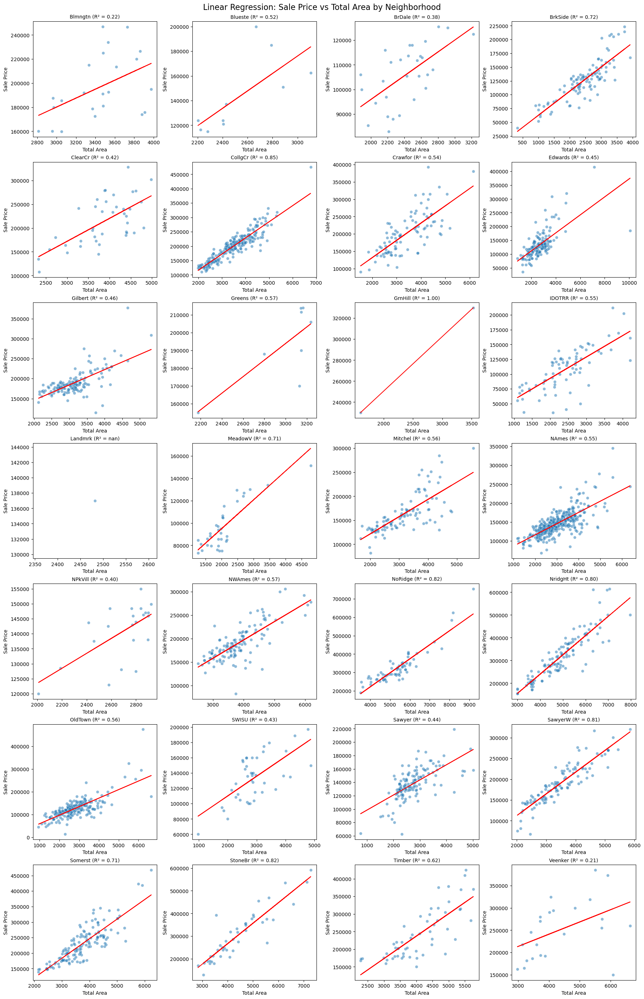

In [17]:
# Prepare data
df = price[['Neighborhood', 'TotalArea', 'SalePrice']].dropna()

# Get sorted list of neighborhoods
neighborhoods = sorted(df['Neighborhood'].unique())

# Plot layout
num_plots = len(neighborhoods)
num_cols = 4
num_rows = (num_plots + num_cols - 1) // num_cols

fig, axes = plt.subplots(num_rows, num_cols, figsize=(18, num_rows * 4), constrained_layout=True)
axes = axes.flatten()

# Loop through neighborhoods
for i, neighborhood in enumerate(neighborhoods):
    ax = axes[i]
    
    data = df[df['Neighborhood'] == neighborhood]
    X = data[['TotalArea']]
    y = data['SalePrice']
    
    # Fit linear regression
    model = LinearRegression().fit(X, y)
    y_pred = model.predict(X)
    
    # Calculate R²
    r2 = model.score(X, y)

    # Plot scatter and regression line
    sns.scatterplot(x='TotalArea', y='SalePrice', data=data, ax=ax, alpha=0.5)
    ax.plot(X, y_pred, color='red')
    
    # Set title with R²
    ax.set_title(f"{neighborhood} (R² = {r2:.2f})", fontsize=10)
    ax.set_xlabel('Total Area')
    ax.set_ylabel('Sale Price')

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle('Linear Regression: Sale Price vs Total Area by Neighborhood', fontsize=16)
plt.show()

In [18]:
columns_to_sum1 = [
    'BsmtFullBath', 'FullBath'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalFullBath'] = price[columns_to_sum1].fillna(0).sum(axis=1)

columns_to_sum2 = [
    'BsmtHalfBath', 'HalfBath'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalHalfBath'] = price[columns_to_sum2].fillna(0).sum(axis=1)

In [19]:
# Select variables
features = ['TotalArea', 'TotalFullBath', 'TotalHalfBath', 'TotRmsAbvGrd', 'OverallQual']
target = 'SalePrice'

multi_feats = price[features + [target]].fillna(0)

# Define X and y
X = multi_feats[features]
y = multi_feats[target]

# Fit model
model = LinearRegression()
model.fit(X, y)

# Predict
y_pred = model.predict(X)

# Calculate R² and RSS
r2 = r2_score(y, y_pred)
rss = np.sum((y - y_pred) ** 2)

# Coefficients
coefficients = dict(zip(features, model.coef_))
intercept = model.intercept_

# Display results
print("Intercept:", round(intercept, 2))
print("Coefficients:")
for feature, coef in coefficients.items():
    print(f"  {feature}: {round(coef, 2)}")

print(f"\nR²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

Intercept: -83599.09
Coefficients:
  TotalArea: 39.71
  TotalFullBath: 9807.93
  TotalHalfBath: 5938.21
  TotRmsAbvGrd: -1651.94
  OverallQual: 19872.12

R²: 0.8190
RSS: 2,627,420,725,245.89


In [20]:
# Define features and target
features = ['TotalArea', 'Neighborhood']
target = 'SalePrice'

# Fill missing values with 0
hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = hood[features]
y = hood[target]

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first'), ['Neighborhood'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', LinearRegression())
])

# Fit model
pipeline.fit(X, y)

# Predict and evaluate
y_pred = pipeline.predict(X)
r2 = r2_score(y, y_pred)
rss = np.sum((y - y_pred) ** 2)

# Output
print(f"R²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

R²: 0.8169
RSS: 2,659,017,117,779.20


In [21]:
# Define features and target
features = ['PoolArea', 'EnclosedPorch', 'ScreenPorch', 'OpenPorchSF', 'WoodDeckSF', '3SsnPorch', 
            'GarageArea', 'GrLivArea', 'TotalBsmtSF', 'MasVnrArea', 'Neighborhood']
target = 'SalePrice'

# Fill missing values with 0
hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = hood[features]
y = hood[target]

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first'), ['Neighborhood'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', LinearRegression())
])

# Fit model
pipeline.fit(X, y)

# Predict and evaluate
y_pred = pipeline.predict(X)
r2 = r2_score(y, y_pred)
rss = np.sum((y - y_pred) ** 2)

# Output
print(f"R²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

R²: 0.8216
RSS: 2,589,581,229,543.38


In [22]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 'Foundation', 
            'OverallQual', 'TotalFullBath', 'TotalHalfBath', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 
            'LotConfig', 'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 'CentralAir',
            'KitchenQual', 'SaleType']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first'), ['Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 
                                              'Foundation', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 'LotConfig', 
                                              'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 
                                              'CentralAir', 'KitchenQual', 'SaleType'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', LinearRegression())
])

# Fit model
pipeline.fit(X, y)

# Predict and evaluate
y_pred = pipeline.predict(X)
r2 = r2_score(y, y_pred)
rss = np.sum((y - y_pred) ** 2)

# Output
print(f"R²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

R²: 0.8989
RSS: 1,468,073,636,237.86


In [23]:
# Define features and target
features = ['PoolArea', 'EnclosedPorch', 'ScreenPorch', 'OpenPorchSF', 'WoodDeckSF', '3SsnPorch', 
            'GarageArea', 'GrLivArea', 'TotalBsmtSF', 'MasVnrArea', 'Neighborhood', 'MSSubClass', 'PoolQC', 
            'GarageQual', 'GarageType', 'Foundation', 'OverallQual', 'TotalFullBath', 'TotalHalfBath', 'BsmtFinType1', 
            'BsmtFinType2', 'MSZoning', 'LotConfig', 'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 
            'Heating', 'CentralAir', 'KitchenQual', 'SaleType']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first'), ['Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 
                                              'Foundation', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 'LotConfig', 
                                              'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 
                                              'CentralAir', 'KitchenQual', 'SaleType'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', LinearRegression())
])

# Fit model
pipeline.fit(X, y)

# Predict and evaluate
y_pred = pipeline.predict(X)
r2 = r2_score(y, y_pred)
rss = np.sum((y - y_pred) ** 2)

# Output
print(f"R²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

R²: 0.9023
RSS: 1,418,188,317,947.41


In [24]:
# Define what counts as a finished basement
finished_basement_types = ['GLQ', 'ALQ', 'BLQ', 'Rec', 'LwQ']

# Create new total room feature including finished basement types
price['TotalFinishedRooms'] = (
    price['TotRmsAbvGrd'] +
    price['BsmtFinType1'].apply(lambda x: 1 if x in finished_basement_types else 0) +
    price['BsmtFinType2'].apply(lambda x: 1 if x in finished_basement_types else 0)
)

price['TotalBathrooms'] = (
    price['FullBath'].fillna(0) +
    price['HalfBath'].fillna(0) * 0.5 +
    price['BsmtFullBath'].fillna(0) +
    price['BsmtHalfBath'].fillna(0) * 0.5
)

price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea,TotalFullBath,TotalHalfBath,TotalFinishedRooms,TotalBathrooms
0,909176150,856,126000,30,RL,68.516053,7890,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,TA,CBlock,TA,TA,No,Rec,238,Unf,0,618,856,GasA,TA,Y,SBrkr,856,0,0,1,0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2,399,TA,TA,Y,0,0,0,0,166,0,No Pool,No Fence,None,0,3,2010,WD,Normal,2277.0,2,0,5,2.0
1,905476230,1049,139500,120,RL,42.000000,4235,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552,ALQ,393,104,1049,GasA,TA,Y,SBrkr,1049,0,0,1,0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1984.0,Fin,1,266,TA,TA,Y,0,105,0,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2618.0,3,0,7,3.0
2,911128020,1001,124900,30,C (all),60.000000,6060,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,None,0,Gd,TA,BrkTil,TA,TA,No,ALQ,737,Unf,0,100,837,GasA,Ex,Y,SBrkr,1001,0,0,0,0,1,0,2,1,Gd,5,Typ,0,No Fireplace,Detchd,1930.0,Unf,1,216,TA,Po,N,154,0,42,86,0,0,No Pool,No Fence,None,0,11,2007,WD,Normal,2336.0,1,0,6,1.0
3,535377150,1039,114000,70,RL,80.000000,8146,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,None,0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0,Unf,0,405,405,GasA,Gd,Y,SBrkr,717,322,0,0,0,1,0,2,1,TA,6,Typ,0,No Fireplace,Detchd,1940.0,Unf,1,281,TA,TA,N,0,0,168,0,111,0,No Pool,No Fence,None,0,5,2009,WD,Normal,2004.0,1,0,6,1.0
4,534177230,1665,227000,60,RL,70.000000,8400,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,None,0,Gd,TA,PConc,Gd,TA,No,GLQ,643,Unf,0,167,810,GasA,Ex,Y,SBrkr,810,855,0,1,0,2,1,3,1,Gd,6,Typ,0,No Fireplace,Attchd,2001.0,Fin,2,528,TA,TA,Y,0,45,0,0,0,0,No Pool,No Fence,None,0,11,2009,WD,Normal,3048.0,3,1,7,3.5
5,908128060,1922,198500,85,RL,64.000000,7301,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500,Gd,TA,Slab,No Basement,No Basement,No Basement,No Basement,0,No Basement,0,0,0,GasA,Ex,Y,SBrkr,495,1427,0,0,0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2,672,TA,TA,Y,0,0,177,0,0,0,No Pool,No Fence,None,0,7,2009,ConLD,Normal,3271.0,3,0,7,3.0
6,902135020,936,93000,20,RM,60.000000,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,None,0,Fa,TA,CBlock,Fa,TA,No,Unf,0,Unf,0,936,936,GasA,TA,N,SBrkr,936,0,0,0,0,1,0,2,1,TA,4,Min2,0,No Fireplace,Detchd,1974.0,Unf,2,576,TA,TA,Y,0,32,112,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2592.0,1,0,4,1.0
7,528228540,1246,187687,20,RL,53.000000,3710,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20,Gd,TA,PConc,Gd,TA,Gd,Unf,0,Unf,0,1146,1146,GasA,Ex,Y,SBrkr,1246,0,0,0,0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2,428,TA,TA,Y,100,24,0,0,0,0,No Pool,No Fence,None,0,3,2008,New,Partial,2964.0,2,0

In [25]:
# Define features and target
features_25 = ['PoolArea', 'EnclosedPorch', 'ScreenPorch', 'OpenPorchSF', 'WoodDeckSF', '3SsnPorch', 
            'GarageArea', 'GrLivArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'MasVnrArea', 'Neighborhood', 'Foundation', 
            'GarageType', 'MSSubClass', 'FireplaceQu', 'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 
            'TotalHalfBath', 'ExterQual', 'BsmtQual', 'BsmtExposure', 'TotalFullBath']
target_25 = 'SalePrice' 


# Separate predictors and response
X_25 = price[features_25]
y_25 = price[target_25]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_25 = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass',
                                              'FireplaceQu', 'ExterQual', 'BsmtQual', 'BsmtExposure'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_25 = Pipeline([
    ('prep', preprocessor_25),
    ('reg', LinearRegression())
])

# Fit model
pipeline_25.fit(X_25, y_25)

# Predict and evaluate
y_pred_25 = pipeline_25.predict(X_25)
r2_25 = r2_score(y_25, y_pred_25)
rss_25 = np.sum((y_25 - y_pred_25) ** 2)

# Cross-validation scores
cv_scores_25 = cross_val_score(pipeline_25, X_25, y_25, scoring='r2', cv=5)

# Output
print('25 Features')
print(f"R²: {r2_25:.4f}")
print(f"RSS: {rss_25:,.2f}")
print(cv_scores_25)
print(cv_scores_25.mean())

25 Features
R²: 0.9102
RSS: 1,303,917,372,432.82
[0.86794553 0.90878715 0.9156098  0.90588645 0.90422014]
0.9004898125429381


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [26]:
# Define features and target
features_14 = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target_14 = 'SalePrice' 

# Separate predictors and response
X_14 = price[features_14]
y_14 = price[target_14]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_14 = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass',
                                              'FireplaceQu', 'ExterQual', 'BsmtQual', 'BsmtExposure'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_14 = Pipeline([
    ('prep', preprocessor_14),
    ('reg', LinearRegression())
])

# Fit model
pipeline_14.fit(X_14, y_14)

# Predict and evaluate
y_pred_14 = pipeline_14.predict(X_14)
r2_14 = r2_score(y_14, y_pred_14)
rss_14 = np.sum((y_14 - y_pred_14) ** 2)

# Cross-validation scores
cv_scores_14 = cross_val_score(pipeline_14, X_14, y_14, scoring='r2', cv=5)

# Output
print('14 Features')
print(f"R²: {r2_14:.4f}")
print(f"RSS: {rss_14:,.2f}")
print(cv_scores_14)
print(cv_scores_14.mean())

14 Features
R²: 0.9003
RSS: 1,447,621,706,371.27
[0.86050271 0.8994339  0.90742726 0.89085743 0.89431368]
0.8905069958869062


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [27]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features_no_tot = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice', 'TotalArea']).columns
categorical_features_no_tot = price.select_dtypes(include=['object']).columns

X_no_tot = price[numeric_features_no_tot.tolist() + categorical_features_no_tot.tolist()]
 
# Target variable
y_no_tot = price['SalePrice']
 
 
# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_no_tot = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_features_no_tot)  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)



# Create pipeline: preprocessing + linear regression
pipeline_no_tot = Pipeline([
    ('prep', preprocessor_no_tot),
    ('reg', LinearRegression())
])

# Fit model
pipeline_no_tot.fit(X_no_tot, y_no_tot)

# Predict and evaluate
y_pred_no_tot = pipeline_no_tot.predict(X_no_tot)
r2_no_tot = r2_score(y_no_tot, y_pred_no_tot)
rss_no_tot = np.sum((y_no_tot - y_pred_no_tot) ** 2)

# Cross-validation scores
cv_scores_no_tot = cross_val_score(pipeline_no_tot, X_no_tot, y_no_tot, scoring='r2', cv=5)

# Output
print('All Features Except Total Area')
print(f"R²: {r2_no_tot:.4f}")
print(f"RSS: {rss_no_tot:,.2f}")
print(cv_scores_no_tot)
print(cv_scores_no_tot.mean())

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [15, 30, 31, 34] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [14, 27, 34, 41, 42] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [8, 14, 15, 16, 34] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [10, 19, 34] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


All Features Except Total Area
R²: 0.9308
RSS: 1,004,939,284,210.51
[0.86478822 0.91341227 0.92369543 0.91754021 0.9189876 ]
0.9076847463915059


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 5, 10, 15, 16, 26] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [28]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features_all = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features_all = price.select_dtypes(include=['object']).columns

X_all = price[numeric_features_all.tolist() + categorical_features_all.tolist()]
 
# Target variable
y_all = price['SalePrice']
 
 
# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_all = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_features_all)  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)



# Create pipeline: preprocessing + linear regression
pipeline_all = Pipeline([
    ('prep', preprocessor_all),
    ('reg', LinearRegression())
])

# Fit model
pipeline_all.fit(X_all, y_all)

# Predict and evaluate
y_pred_all = pipeline_all.predict(X_all)
r2_all = r2_score(y_all, y_pred_all)
rss_all = np.sum((y_all - y_pred_all) ** 2)

# Cross-validation scores
cv_scores_all = cross_val_score(pipeline_all, X_all, y_all, scoring='r2', cv=5)

# Output
print('All Features')
print(f"R²: {r2_all:.4f}")
print(f"RSS: {rss_all:,.2f}")
print(cv_scores_all)
print(cv_scores_all.mean())

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [15, 30, 31, 34] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [14, 27, 34, 41, 42] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [8, 14, 15, 16, 34] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [10, 19, 34] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


All Features
R²: 0.9308
RSS: 1,004,287,798,519.30
[0.86326765 0.91553264 0.92600101 0.91629201 0.92130404]
0.9084794722327455


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 5, 10, 15, 16, 26] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [29]:
# Define features and target
features_6 = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQual', 'TotalArea', 'Neighborhood']
target_6 = 'SalePrice' 


# Separate predictors and response
X_6 = price[features_6]
y_6 = price[target_6]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_6 = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop = 'first', handle_unknown='ignore'), ['Neighborhood'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_6 = Pipeline([
    ('prep', preprocessor_6),
    ('reg', LinearRegression())
])

# Fit model
pipeline_6.fit(X_6, y_6)

# Predict and evaluate
y_pred_6 = pipeline_6.predict(X_6)
r2_6 = r2_score(y_6, y_pred_6)
rss_6 = np.sum((y_6 - y_pred_6) ** 2)

# Cross-validation scores
cv_scores_6 = cross_val_score(pipeline_6, X_6, y_6, scoring='r2', cv=5)

# Output
print('6 Features')
print(f"R²: {r2_6:.4f}")
print(f"RSS: {rss_6:,.2f}")
print(cv_scores_6)
print(cv_scores_6.mean())

6 Features
R²: 0.8744
RSS: 1,823,053,179,910.61
[0.84204004 0.87345428 0.88329541 0.87535504 0.8764836 ]
0.8701256722716139


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [30]:
outside_to_sum = [
    '3SsnPorch', 'EnclosedPorch', 'ScreenPorch', 'OpenPorchSF', 'WoodDeckSF', 'LotFrontage'  
]

# Make sure all NaNs are treated as 0 before summing
price['Outside'] = price[outside_to_sum].fillna(0).sum(axis=1)

In [31]:
house_to_sum = [
    'GarageArea', 'GrLivArea', 'TotalBsmtSF', 'MasVnrArea'  
]

# Make sure all NaNs are treated as 0 before summing
price['HouseSF'] = price[house_to_sum].fillna(0).sum(axis=1)

In [32]:
# Define features and target
features_7 = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQual', 'TotalArea', 
              'Neighborhood', 'BsmtQual']
target_7 = 'SalePrice' 


# Separate predictors and response
X_7 = price[features_7]
y_7 = price[target_7]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_7 = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop = 'first', handle_unknown='ignore'), ['Neighborhood', 'BsmtQual'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_7 = Pipeline([
    ('prep', preprocessor_7),
    ('reg', LinearRegression())
])

# Fit model
pipeline_7.fit(X_7, y_7)

# Predict and evaluate
y_pred_7 = pipeline_7.predict(X_7)
r2_7 = r2_score(y_7, y_pred_7)
rss_7 = np.sum((y_7 - y_pred_7) ** 2)

# Cross-validation scores
cv_scores_7 = cross_val_score(pipeline_7, X_7, y_7, scoring='r2', cv=5)

# Output
print('7 Features')
print(f"R²: {r2_7:.4f}")
print(f"RSS: {rss_7:,.2f}")
print(cv_scores_7)
print(cv_scores_7.mean())

7 Features
R²: 0.8835
RSS: 1,691,617,625,293.70
[0.8475785  0.88176199 0.89249069 0.88194541 0.88569595]
0.8778945088811551


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [33]:
# Define features and target
features_8 = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQual', 'TotalArea', 
              'Neighborhood', 'BsmtQual', 'OverallCond']
target_8 = 'SalePrice' 


# Separate predictors and response
X_8 = price[features_8]
y_8 = price[target_8]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_8 = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop = 'first', handle_unknown='ignore'), ['Neighborhood', 'BsmtQual'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_8 = Pipeline([
    ('prep', preprocessor_8),
    ('reg', LinearRegression())
])

# Fit model
pipeline_8.fit(X_8, y_8)

# Predict and evaluate
y_pred_8 = pipeline_8.predict(X_8)
r2_8 = r2_score(y_8, y_pred_8)
rss_8 = np.sum((y_8 - y_pred_8) ** 2)

# Cross-validation scores
cv_scores_8 = cross_val_score(pipeline_8, X_8, y_8, scoring='r2', cv=5)

# Output
print('8 Features')
print(f"R²: {r2_8:.4f}")
print(f"RSS: {rss_8:,.2f}")
print(cv_scores_8)
print(cv_scores_8.mean())

8 Features
R²: 0.8872
RSS: 1,638,050,965,073.95
[0.85685494 0.88203816 0.89826612 0.88555584 0.88923054]
0.8823891212404587


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [34]:
# First, coerce all to numeric (errors='coerce' will make problematic values NaN)
price['GarageYrBlt'] = pd.to_numeric(price['GarageYrBlt'], errors='coerce')

price['GarageYrBlt'] = price['GarageYrBlt'].fillna(0).astype('int64')

price['MSSubClass'] = price['MSSubClass'].astype('object')

In [35]:
# Define features and target
features_9 = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQual', 'TotalArea', 
              'Neighborhood', 'BsmtQual', 'OverallCond', 'KitchenQual']
target_9 = 'SalePrice' 


# Separate predictors and response
X_9 = price[features_9]
y_9 = price[target_9]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_9 = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'BsmtQual', 'KitchenQual', 'MSSubClass'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_9 = Pipeline([
    ('prep', preprocessor_9),
    ('reg', LinearRegression())
])

# Fit model
pipeline_9.fit(X_9, y_9)

# Predict and evaluate
y_pred_9 = pipeline_9.predict(X_9)
r2_9 = r2_score(y_9, y_pred_9)
rss_9 = np.sum((y_9 - y_pred_9) ** 2)

# Cross-validation scores
cv_scores_9 = cross_val_score(pipeline_9, X_9, y_9, scoring='r2', cv=5)

# Output
print('9 Features')
print(f"R²: {r2_9:.4f}")
print(f"RSS: {rss_9:,.2f}")
print(cv_scores_9)
print(cv_scores_9.mean())

9 Features
R²: 0.8970
RSS: 1,495,145,379,934.39
[0.85930422 0.891506   0.90426704 0.89727394 0.90124467]
0.8907191752176347


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


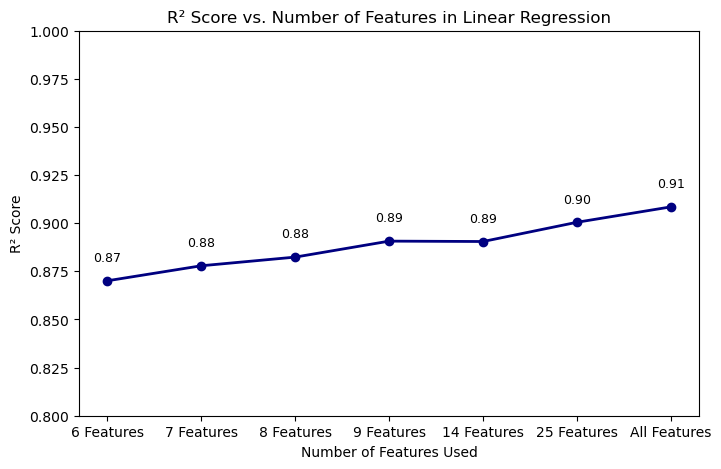

In [36]:
r2_scores_norm = [0.8701, 0.8779, 0.8824, 0.8907, 0.8905, .9005, .9085]
feature_sets = ['6 Features', '7 Features', '8 Features', '9 Features', '14 Features', '25 Features', 'All Features']

plt.figure(figsize=(8,5))
plt.plot(feature_sets, r2_scores_norm, marker='o', color='navy', linestyle='-', linewidth=2)
plt.title('R² Score vs. Number of Features in Linear Regression')
plt.xlabel('Number of Features Used')
plt.ylabel('R² Score')
plt.ylim(0.8, 1)  # R² ranges from 0 to 1

# Annotate R² scores on the graph
for i, score in enumerate(r2_scores_norm):
    plt.text(feature_sets[i], score + 0.01, f'{score:.2f}', ha='center', fontsize=9)

plt.show()

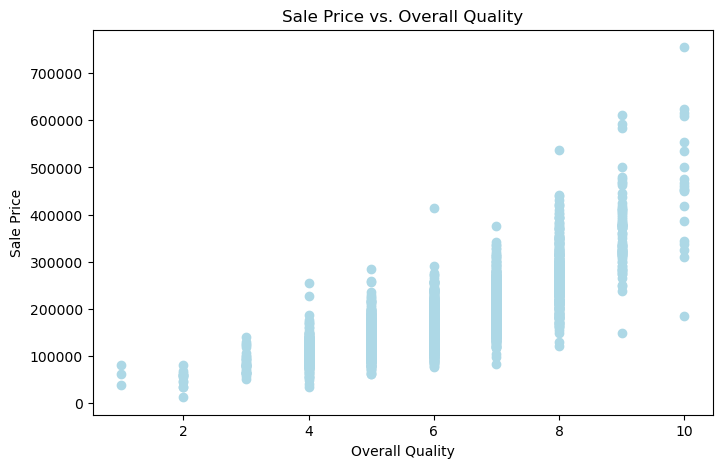

In [37]:
plt.figure(figsize=(8,5))
plt.scatter(x=price['OverallQual'], y=price['SalePrice'], color='lightblue')
plt.xlabel('Overall Quality')          # X-axis label
plt.ylabel('Sale Price')               # Y-axis label
plt.title('Sale Price vs. Overall Quality')  # Title
plt.show()

In [38]:
price['OverallQualSq'] = price['OverallQual']**2
price['OverallQualCu'] = price['OverallQual']**3

In [39]:
# Define features and target
features_6_sq = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQualSq', 'TotalArea', 
              'Neighborhood']
target_6_sq = 'SalePrice' 


# Separate predictors and response
X_6_sq = price[features_6_sq]
y_6_sq = price[target_6_sq]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_6_sq = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'MSSubClass'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_6_sq = Pipeline([
    ('prep', preprocessor_6_sq),
    ('reg', LinearRegression())
])

# Fit model
pipeline_6_sq.fit(X_6_sq, y_6_sq)

# Predict and evaluate
y_pred_6_sq = pipeline_6_sq.predict(X_6_sq)
r2_6_sq = r2_score(y_6_sq, y_pred_6_sq)
rss_6_sq = np.sum((y_6_sq - y_pred_6_sq) ** 2)

# Cross-validation scores
cv_scores_6_sq = cross_val_score(pipeline_6_sq, X_6_sq, y_6_sq, scoring='r2', cv=5)

# Output
print('6 Features with Overall Quality Squared')
print(f"R²: {r2_6_sq:.4f}")
print(f"RSS: {rss_6_sq:,.2f}")
print(cv_scores_6_sq)
print(cv_scores_6_sq.mean())

6 Features with Overall Quality Squared
R²: 0.8857
RSS: 1,659,776,994,309.68
[0.84828142 0.88569272 0.89432539 0.88860215 0.88492776]
0.8803658878480931


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [1] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [40]:
# Define features and target
features_6_cu = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQualCu', 'TotalArea', 
              'Neighborhood']
target_6_cu = 'SalePrice' 


# Separate predictors and response
X_6_cu = price[features_6_cu]
y_6_cu = price[target_6_cu]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_6_cu = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'MSSubClass'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_6_cu = Pipeline([
    ('prep', preprocessor_6_cu),
    ('reg', LinearRegression())
])

# Fit model
pipeline_6_cu.fit(X_6_cu, y_6_cu)

# Predict and evaluate
y_pred_6_cu = pipeline_6_cu.predict(X_6_cu)
r2_6_cu = r2_score(y_6_cu, y_pred_6_cu)
rss_6_cu = np.sum((y_6_cu - y_pred_6_cu) ** 2)

# Cross-validation scores
cv_scores_6_cu = cross_val_score(pipeline_6_cu, X_6_cu, y_6_cu, scoring='r2', cv=5)

# Output
print('6 Features with Overall Quality Cubed')
print(f"R²: {r2_6_cu:.4f}")
print(f"RSS: {rss_6_cu:,.2f}")
print(cv_scores_6_cu)
print(cv_scores_6_cu.mean())

6 Features with Overall Quality Cubed
R²: 0.8907
RSS: 1,586,634,101,627.49
[0.8492672  0.89163884 0.90139161 0.89751595 0.89001589]
0.8859658986274613


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [1] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [41]:
# Define features and target
features_7_sq = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQualSq', 'TotalArea', 
              'Neighborhood', 'BsmtQual']
target_7_sq = 'SalePrice' 


# Separate predictors and response
X_7_sq = price[features_7_sq]
y_7_sq = price[target_7_sq]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_7_sq = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'BsmtQual', 'MSSubClass'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_7_sq = Pipeline([
    ('prep', preprocessor_7_sq),
    ('reg', LinearRegression())
])

# Fit model
pipeline_7_sq.fit(X_7_sq, y_7_sq)

# Predict and evaluate
y_pred_7_sq = pipeline_7_sq.predict(X_7_sq)
r2_7_sq = r2_score(y_7_sq, y_pred_7_sq)
rss_7_sq = np.sum((y_7_sq - y_pred_7_sq) ** 2)

# Cross-validation scores
cv_scores_7_sq = cross_val_score(pipeline_7_sq, X_7_sq, y_7_sq, scoring='r2', cv=5)

# Output
print('7 Features with Overall Quality Squared')
print(f"R²: {r2_7_sq:.4f}")
print(f"RSS: {rss_7_sq:,.2f}")
print(cv_scores_7_sq)
print(cv_scores_7_sq.mean())

7 Features with Overall Quality Squared
R²: 0.8921
RSS: 1,566,448,273,585.49
[0.85131886 0.89247434 0.90122357 0.89314884 0.8915346 ]
0.885940043243424


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [42]:
# Define features and target
features_7_cu = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQualCu', 'TotalArea', 
              'Neighborhood', 'BsmtQual']
target_7_cu = 'SalePrice' 


# Separate predictors and response
X_7_cu = price[features_7_cu]
y_7_cu = price[target_7_cu]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_7_cu = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'BsmtQual', 'MSSubClass'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_7_cu = Pipeline([
    ('prep', preprocessor_7_cu),
    ('reg', LinearRegression())
])

# Fit model
pipeline_7_cu.fit(X_7_cu, y_7_cu)

# Predict and evaluate
y_pred_7_cu = pipeline_7_cu.predict(X_7_cu)
r2_7_cu = r2_score(y_7_cu, y_pred_7_cu)
rss_7_cu = np.sum((y_7_cu - y_pred_7_cu) ** 2)

# Cross-validation scores
cv_scores_7_cu = cross_val_score(pipeline_7_cu, X_7_cu, y_7_cu, scoring='r2', cv=5)

# Output
print('7 Features with Overall Quality Cubed')
print(f"R²: {r2_7_cu:.4f}")
print(f"RSS: {rss_7_cu:,.2f}")
print(cv_scores_7_cu)
print(cv_scores_7_cu.mean())

7 Features with Overall Quality Cubed
R²: 0.8951
RSS: 1,523,368,691,732.67
[0.85129181 0.89536828 0.90583461 0.90008305 0.89474087]
0.8894637239443342


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [43]:
# Define features and target
features_8_sq = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQualSq', 'TotalArea', 
              'Neighborhood', 'BsmtQual', 'OverallCond']
target_8_sq = 'SalePrice' 


# Separate predictors and response
X_8_sq = price[features_8_sq]
y_8_sq = price[target_8_sq]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_8_sq = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'BsmtQual', 'MSSubClass'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_8_sq = Pipeline([
    ('prep', preprocessor_8_sq),
    ('reg', LinearRegression())
])

# Fit model
pipeline_8_sq.fit(X_8_sq, y_8_sq)

# Predict and evaluate
y_pred_8_sq = pipeline_8_sq.predict(X_8_sq)
r2_8_sq = r2_score(y_8_sq, y_pred_8_sq)
rss_8_sq = np.sum((y_8_sq - y_pred_8_sq) ** 2)

# Cross-validation scores
cv_scores_8_sq = cross_val_score(pipeline_8_sq, X_8_sq, y_8_sq, scoring='r2', cv=5)

# Output
print('8 Features with Overall Quality Squared')
print(f"R²: {r2_8_sq:.4f}")
print(f"RSS: {rss_8_sq:,.2f}")
print(cv_scores_8_sq)
print(cv_scores_8_sq.mean())

8 Features with Overall Quality Squared
R²: 0.8958
RSS: 1,512,298,873,290.79
[0.85792895 0.89175166 0.90715012 0.8956946  0.89495655]
0.8894963770449451


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [44]:
# Define features and target
features_8_cu = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQualCu', 'TotalArea', 
              'Neighborhood', 'BsmtQual', 'OverallCond']
target_8_cu = 'SalePrice' 


# Separate predictors and response
X_8_cu = price[features_8_cu]
y_8_cu = price[target_8_cu]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_8_cu = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'BsmtQual', 'MSSubClass'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_8_cu = Pipeline([
    ('prep', preprocessor_8_cu),
    ('reg', LinearRegression())
])

# Fit model
pipeline_8_cu.fit(X_8_cu, y_8_cu)

# Predict and evaluate
y_pred_8_cu = pipeline_8_cu.predict(X_8_cu)
r2_8_cu = r2_score(y_8_cu, y_pred_8_cu)
rss_8_cu = np.sum((y_8_cu - y_pred_8_cu) ** 2)

# Cross-validation scores
cv_scores_8_cu = cross_val_score(pipeline_8_cu, X_8_cu, y_8_cu, scoring='r2', cv=5)

# Output
print('8 Features with Overall Quality Cubed')
print(f"R²: {r2_8_cu:.4f}")
print(f"RSS: {rss_8_cu:,.2f}")
print(cv_scores_8_cu)
print(cv_scores_8_cu.mean())

8 Features with Overall Quality Cubed
R²: 0.8993
RSS: 1,462,229,219,402.56
[0.85882364 0.89470982 0.91222894 0.9034939  0.89821899]
0.893495057315592


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [45]:
# Define features and target
features_9_sq = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQualSq', 'TotalArea', 
              'Neighborhood', 'BsmtQual', 'OverallCond', 'KitchenQual']
target_9_sq = 'SalePrice' 


# Separate predictors and response
X_9_sq = price[features_9_sq]
y_9_sq = price[target_9_sq]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_9_sq = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'BsmtQual', 'KitchenQual', 'MSSubClass'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_9_sq = Pipeline([
    ('prep', preprocessor_9_sq),
    ('reg', LinearRegression())
])

# Fit model
pipeline_9_sq.fit(X_9_sq, y_9_sq)

# Predict and evaluate
y_pred_9_sq = pipeline_9_sq.predict(X_9_sq)
r2_9_sq = r2_score(y_9_sq, y_pred_9_sq)
rss_9_sq = np.sum((y_9_sq - y_pred_9_sq) ** 2)

# Cross-validation scores
cv_scores_9_sq = cross_val_score(pipeline_9_sq, X_9_sq, y_9_sq, scoring='r2', cv=5)

# Output
print('9 Features with Overall Quality Squared')
print(f"R²: {r2_9_sq:.4f}")
print(f"RSS: {rss_9_sq:,.2f}")
print(cv_scores_9_sq)
print(cv_scores_9_sq.mean())

9 Features with Overall Quality Squared
R²: 0.9002
RSS: 1,449,223,958,161.27
[0.86103281 0.89442174 0.90921102 0.90301512 0.90363566]
0.8942632672910321


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [46]:
# Define features and target
features_9_cu = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQualCu', 'TotalArea', 
              'Neighborhood', 'BsmtQual', 'OverallCond', 'KitchenQual']
target_9_cu = 'SalePrice' 


# Separate predictors and response
X_9_cu = price[features_9_cu]
y_9_cu = price[target_9_cu]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_9_cu = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'BsmtQual', 'KitchenQual', 'MSSubClass'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_9_cu = Pipeline([
    ('prep', preprocessor_9_cu),
    ('reg', LinearRegression())
])

# Fit model
pipeline_9_cu.fit(X_9_cu, y_9_cu)

# Predict and evaluate
y_pred_9_cu = pipeline_9_cu.predict(X_9_cu)
r2_9_cu = r2_score(y_9_cu, y_pred_9_cu)
rss_9_cu = np.sum((y_9_cu - y_pred_9_cu) ** 2)

# Cross-validation scores
cv_scores_9_cu = cross_val_score(pipeline_9_cu, X_9_cu, y_9_cu, scoring='r2', cv=5)

# Output
print('9 Features with Overall Quality Cubed')
print(f"R²: {r2_9_cu:.4f}")
print(f"RSS: {rss_9_cu:,.2f}")
print(cv_scores_9_cu)
print(cv_scores_9_cu.mean())

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


9 Features with Overall Quality Cubed
R²: 0.9024
RSS: 1,416,573,451,632.04
[0.86182164 0.8963971  0.91326724 0.90830774 0.90534758]
0.8970282598417514


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [47]:
# Define features and target
features_14_sq = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQualSq', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target_14_sq = 'SalePrice' 

# Separate predictors and response
X_14_sq = price[features_14_sq]
y_14_sq = price[target_14_sq]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_14_sq = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass',
                                              'FireplaceQu', 'ExterQual', 'BsmtQual', 'BsmtExposure'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_14_sq = Pipeline([
    ('prep', preprocessor_14_sq),
    ('reg', LinearRegression())
])

# Fit model
pipeline_14_sq.fit(X_14_sq, y_14_sq)

# Predict and evaluate
y_pred_14_sq = pipeline_14_sq.predict(X_14_sq)
r2_14_sq = r2_score(y_14_sq, y_pred_14_sq)
rss_14_sq = np.sum((y_14_sq - y_pred_14_sq) ** 2)

# Cross-validation scores
cv_scores_14_sq = cross_val_score(pipeline_14_sq, X_14_sq, y_14_sq, scoring='r2', cv=5)

# Output
print('14 Features with Overall Quality Squared')
print(f"R²: {r2_14_sq:.4f}")
print(f"RSS: {rss_14_sq:,.2f}")
print(cv_scores_14_sq)
print(cv_scores_14_sq.mean())

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


14 Features with Overall Quality Squared
R²: 0.9025
RSS: 1,415,228,455,056.29
[0.86192069 0.90012064 0.91006049 0.89623688 0.89706311]
0.893080362988014


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [48]:
# Define features and target
features_14_cu = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQualCu', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target_14_cu = 'SalePrice' 

# Separate predictors and response
X_14_cu = price[features_14_cu]
y_14_cu = price[target_14_cu]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_14_cu = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass',
                                              'FireplaceQu', 'ExterQual', 'BsmtQual', 'BsmtExposure'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_14_cu = Pipeline([
    ('prep', preprocessor_14_cu),
    ('reg', LinearRegression())
])

# Fit model
pipeline_14_cu.fit(X_14_cu, y_14_cu)

# Predict and evaluate
y_pred_14_cu = pipeline_14_cu.predict(X_14_cu)
r2_14_cu = r2_score(y_14_cu, y_pred_14_cu)
rss_14_cu = np.sum((y_14_cu - y_pred_14_cu) ** 2)

# Cross-validation scores
cv_scores_14_cu = cross_val_score(pipeline_14_cu, X_14_cu, y_14_cu, scoring='r2', cv=5)

# Output
print('14 Features with Overall Quality Cubed')
print(f"R²: {r2_14_cu:.4f}")
print(f"RSS: {rss_14_cu:,.2f}")
print(cv_scores_14_cu)
print(cv_scores_14_cu.mean())

14 Features with Overall Quality Cubed
R²: 0.9043
RSS: 1,389,473,642,963.54
[0.86354332 0.90034256 0.91261332 0.90118775 0.89901082]
0.8953395544941646


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [49]:
# Define features and target
features_25_sq = ['PoolArea', 'EnclosedPorch', 'ScreenPorch', 'OpenPorchSF', 'WoodDeckSF', '3SsnPorch', 
            'GarageArea', 'GrLivArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'MasVnrArea', 'Neighborhood', 'Foundation', 
            'GarageType', 'MSSubClass', 'FireplaceQu', 'TotRmsAbvGrd', 'OverallQualSq', 'OverallCond', 
            'TotalHalfBath', 'ExterQual', 'BsmtQual', 'BsmtExposure', 'TotalFullBath']
target_25_sq = 'SalePrice' 


# Separate predictors and response
X_25_sq = price[features_25_sq]
y_25_sq = price[target_25_sq]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_25_sq = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass',
                                              'FireplaceQu', 'ExterQual', 'BsmtQual', 'BsmtExposure'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_25_sq = Pipeline([
    ('prep', preprocessor_25_sq),
    ('reg', LinearRegression())
])

# Fit model
pipeline_25_sq.fit(X_25_sq, y_25_sq)

# Predict and evaluate
y_pred_25_sq = pipeline_25_sq.predict(X_25_sq)
r2_25_sq = r2_score(y_25_sq, y_pred_25_sq)
rss_25_sq = np.sum((y_25_sq - y_pred_25_sq) ** 2)

# Cross-validation scores
cv_scores_25_sq = cross_val_score(pipeline_25_sq, X_25_sq, y_25_sq, scoring='r2', cv=5)

# Output
print('25 Features with Overall Quality Squared')
print(f"R²: {r2_25_sq:.4f}")
print(f"RSS: {rss_25_sq:,.2f}")
print(cv_scores_25_sq)
print(cv_scores_25_sq.mean())

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


25 Features with Overall Quality Squared
R²: 0.9122
RSS: 1,274,745,431,458.23
[0.86828047 0.91039419 0.91904798 0.91065108 0.90643731]
0.9029622040525996


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [50]:
# Define features and target
features_25_cu = ['PoolArea', 'EnclosedPorch', 'ScreenPorch', 'OpenPorchSF', 'WoodDeckSF', '3SsnPorch', 
            'GarageArea', 'GrLivArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'MasVnrArea', 'Neighborhood', 'Foundation', 
            'GarageType', 'MSSubClass', 'FireplaceQu', 'TotRmsAbvGrd', 'OverallQualCu', 'OverallCond', 
            'TotalHalfBath', 'ExterQual', 'BsmtQual', 'BsmtExposure', 'TotalFullBath']
target_25_cu = 'SalePrice' 


# Separate predictors and response
X_25_cu = price[features_25_cu]
y_25_cu = price[target_25_cu]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_25_cu = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass',
                                              'FireplaceQu', 'ExterQual', 'BsmtQual', 'BsmtExposure'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_25_cu = Pipeline([
    ('prep', preprocessor_25_cu),
    ('reg', LinearRegression())
])

# Fit model
pipeline_25_cu.fit(X_25_cu, y_25_cu)

# Predict and evaluate
y_pred_25_cu = pipeline_25_cu.predict(X_25_cu)
r2_25_cu = r2_score(y_25_cu, y_pred_25_cu)
rss_25_cu = np.sum((y_25_cu - y_pred_25_cu) ** 2)

# Cross-validation scores
cv_scores_25_cu = cross_val_score(pipeline_25_cu, X_25_cu, y_25_cu, scoring='r2', cv=5)

# Output
print('25 Features with Overall Quality Cubed')
print(f"R²: {r2_25_cu:.4f}")
print(f"RSS: {rss_25_cu:,.2f}")
print(cv_scores_25_cu)
print(cv_scores_25_cu.mean())

25 Features with Overall Quality Cubed
R²: 0.9139
RSS: 1,249,416,456,323.51
[0.86927647 0.91074838 0.92195457 0.91518121 0.90836494]
0.9051051142936132


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [51]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features_all_sq = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice', 'OverallQual', 'OverallQualCu']).columns
categorical_features_all_sq = price.select_dtypes(include=['object']).columns

X_all_sq = price[numeric_features_all_sq.tolist() + categorical_features_all_sq.tolist()]
 
# Target variable
y_all_sq = price['SalePrice']
 
 
# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_all_sq = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_features_all_sq)  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)



# Create pipeline: preprocessing + linear regression
pipeline_all_sq = Pipeline([
    ('prep', preprocessor_all_sq),
    ('reg', LinearRegression())
])

# Fit model
pipeline_all_sq.fit(X_all_sq, y_all_sq)

# Predict and evaluate
y_pred_all_sq = pipeline_all_sq.predict(X_all_sq)
r2_all_sq = r2_score(y_all_sq, y_pred_all_sq)
rss_all_sq = np.sum((y_all_sq - y_pred_all_sq) ** 2)

# Cross-validation scores
cv_scores_all_sq = cross_val_score(pipeline_all_sq, X_all_sq, y_all_sq, scoring='r2', cv=5)

# Output
print('All Features with Overall Quality Squared')
print(f"R²: {r2_all_sq:.4f}")
print(f"RSS: {rss_all_sq:,.2f}")
print(cv_scores_all_sq)
print(cv_scores_all_sq.mean())

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [16, 31, 32] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [15, 28, 41, 42] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [9, 15, 16, 17] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [11, 20] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


All Features with Overall Quality Squared
R²: 0.9315
RSS: 994,698,172,064.99
[0.86810358 0.91802859 0.9303037  0.92175695 0.92391516]
0.9124215943232692


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 1, 6, 11, 16, 17, 27] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [52]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features_all_cu = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice', 'OverallQual', 'OverallQualSq']).columns
categorical_features_all_cu = price.select_dtypes(include=['object']).columns

X_all_cu = price[numeric_features_all_cu.tolist() + categorical_features_all_cu.tolist()]
 
# Target variable
y_all_cu = price['SalePrice']
 
 
# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_all_cu = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_features_all_cu)  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)



# Create pipeline: preprocessing + linear regression
pipeline_all_cu = Pipeline([
    ('prep', preprocessor_all_cu),
    ('reg', LinearRegression())
])

# Fit model
pipeline_all_cu.fit(X_all_cu, y_all_cu)

# Predict and evaluate
y_pred_all_cu = pipeline_all_cu.predict(X_all_cu)
r2_all_cu = r2_score(y_all_cu, y_pred_all_cu)
rss_all_cu = np.sum((y_all_cu - y_pred_all_cu) ** 2)

# Cross-validation scores
cv_scores_all_cu = cross_val_score(pipeline_all_cu, X_all_cu, y_all_cu, scoring='r2', cv=5)

# Output
print('All Features with Overall Quality Cubed')
print(f"R²: {r2_all_cu:.4f}")
print(f"RSS: {rss_all_cu:,.2f}")
print(cv_scores_all_cu)
print(cv_scores_all_cu.mean())

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [16, 31, 32] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [15, 28, 41, 42] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [9, 15, 16, 17] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [11, 20] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


All Features with Overall Quality Cubed
R²: 0.9318
RSS: 989,669,571,675.30
[0.86689149 0.92006863 0.93233742 0.92433829 0.92633081]
0.9139933267317687


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 1, 6, 11, 16, 17, 27] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


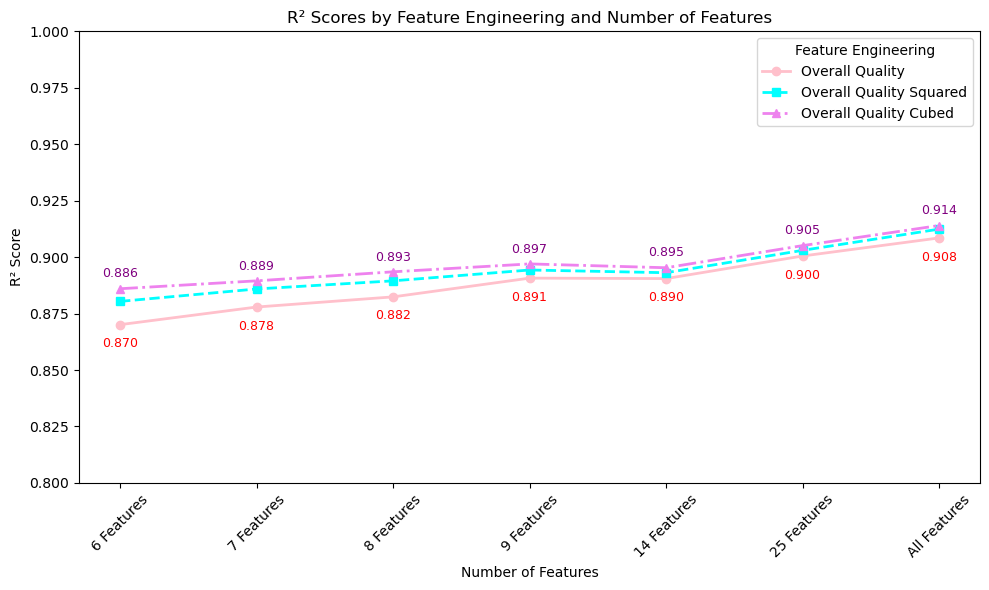

In [137]:
r2_scores_norm = [0.8701, 0.8779, 0.8824, 0.8907, 0.8905, .9005, .9085]
r2_scores_sq = [0.8804, 0.8859, 0.8895, 0.8943, 0.8931, .903, .9124]
r2_scores_cu = [0.886, 0.8895, 0.8935, 0.897, 0.8953, .9051, .914]
feature_sets = ['6 Features', '7 Features', '8 Features', '9 Features', '14 Features', '25 Features', 'All Features']

# X-axis positions (0,1,2,3,...)
x = range(len(feature_sets))

# Plot
plt.figure(figsize=(10,6))
plt.plot(x, r2_scores_norm, marker='o', linestyle='-', label='Overall Quality', linewidth=2, color = 'pink')
plt.plot(x, r2_scores_sq, marker='s', linestyle='--', label='Overall Quality Squared', linewidth=2, color = 'aqua')
plt.plot(x, r2_scores_cu, marker='^', linestyle='-.', label='Overall Quality Cubed', linewidth=2, color = 'violet')

plt.title('R² Scores by Feature Engineering and Number of Features')
plt.xlabel('Number of Features')
plt.ylabel('R² Score')
plt.ylim(0.8, 1.0)
plt.xticks(x, feature_sets, rotation=45)
plt.legend(title='Feature Engineering', loc='upper right')

# Annotate the last point of each line
for i in x:
    plt.text(x[i], r2_scores_norm[i]-0.01, f'{r2_scores_norm[i]:.3f}', ha='center', fontsize=9, color='red')
    plt.text(x[i], r2_scores_cu[i]+0.005,   f'{r2_scores_cu[i]:.3f}',   ha='center', fontsize=9, color='purple')

plt.tight_layout()
plt.show()

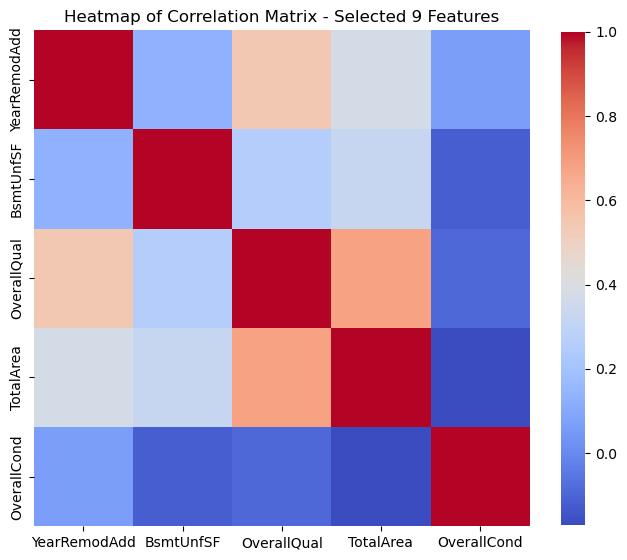

In [179]:
# Make a copy to avoid SettingWithCopyWarning
df_subset = price[features_9].copy()

# Select only numeric columns (don't use .columns here)
df_subset_num = df_subset.select_dtypes(include=['int64', 'float64'])

# Compute correlation matrix for the subset
corr_matrix_subset = df_subset_num.corr()

# Plot heatmap
plt.figure(figsize=(8,8))
sns.heatmap(corr_matrix_subset, cmap='coolwarm', annot=False, fmt='.2f', square=True, cbar_kws={"shrink": .8})
plt.title('Heatmap of Correlation Matrix - Selected 9 Features')
plt.show()

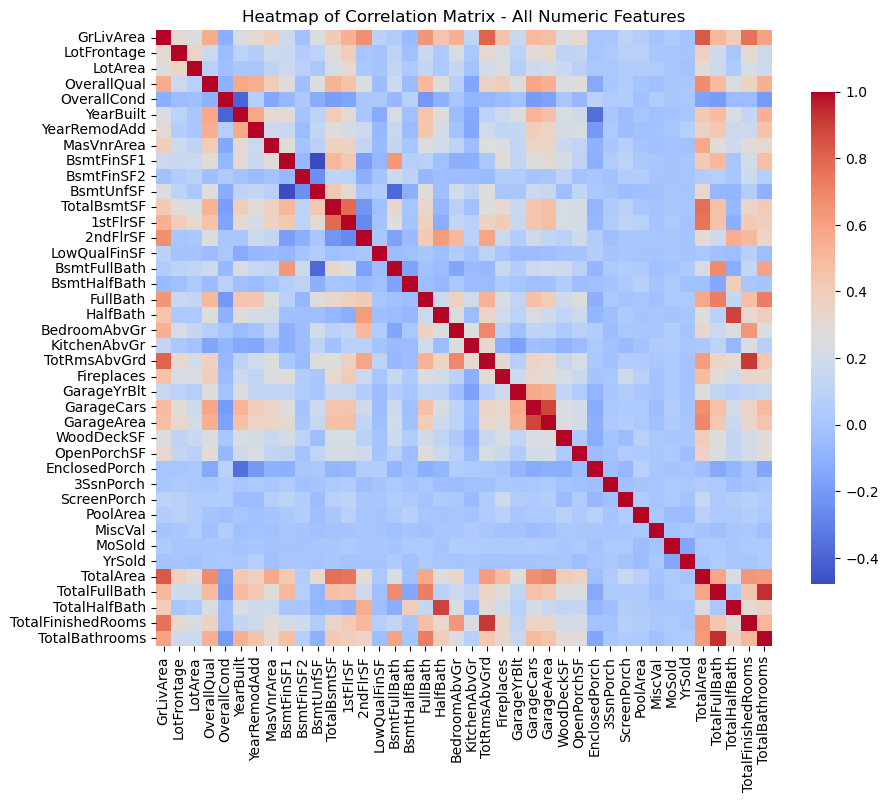

In [155]:
# Select only numeric features
numeric_cols = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'OverallQualSq', 'OverallQualCu', 
                                                                               'HouseSF', 'Outside', 'SalePrice']).columns.tolist()

# Compute correlation matrix
corr_matrix_all = price[numeric_cols].corr()

# Plot heatmap
plt.figure(figsize=(10,8))
sns.heatmap(corr_matrix_all, cmap='coolwarm', annot=False, fmt='.2f', square=True, cbar_kws={"shrink": .8})
plt.title('Heatmap of Correlation Matrix - All Numeric Features')
plt.show()